In [6]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [7]:
import fastai; fastai.__version__
from fastai.vision.all import *

In [8]:
df = pd.read_csv('../input/plant-pathology-2021-fgvc8/train.csv', low_memory=False)
df

,image,labels
0,800113bb65efe69e.jpg,healthy
1,8002cb321f8bfcdf.jpg,scab frog_eye_leaf_spot complex
2,80070f7fb5e2ccaa.jpg,scab
3,80077517781fb94f.jpg,scab
4,800cbf0ff87721f8.jpg,complex
...,...,...
18627,fffb900a92289a33.jpg,healthy
18628,fffc488fa4c0e80c.jpg,scab
18629,fffc94e092a59086.jpg,rust
18630,fffe105cf6808292.jpg,scab frog_eye_leaf_spot


In [9]:
df.labels.value_counts(dropna=False)

scab                               4826
healthy                            4624
frog_eye_leaf_spot                 3181
rust                               1860
complex                            1602
powdery_mildew                     1184
scab frog_eye_leaf_spot             686
scab frog_eye_leaf_spot complex     200
frog_eye_leaf_spot complex          165
rust frog_eye_leaf_spot             120
rust complex                         97
powdery_mildew complex               87
Name: labels, dtype: int64

In [28]:
total = df.labels.value_counts(dropna=False).sum()

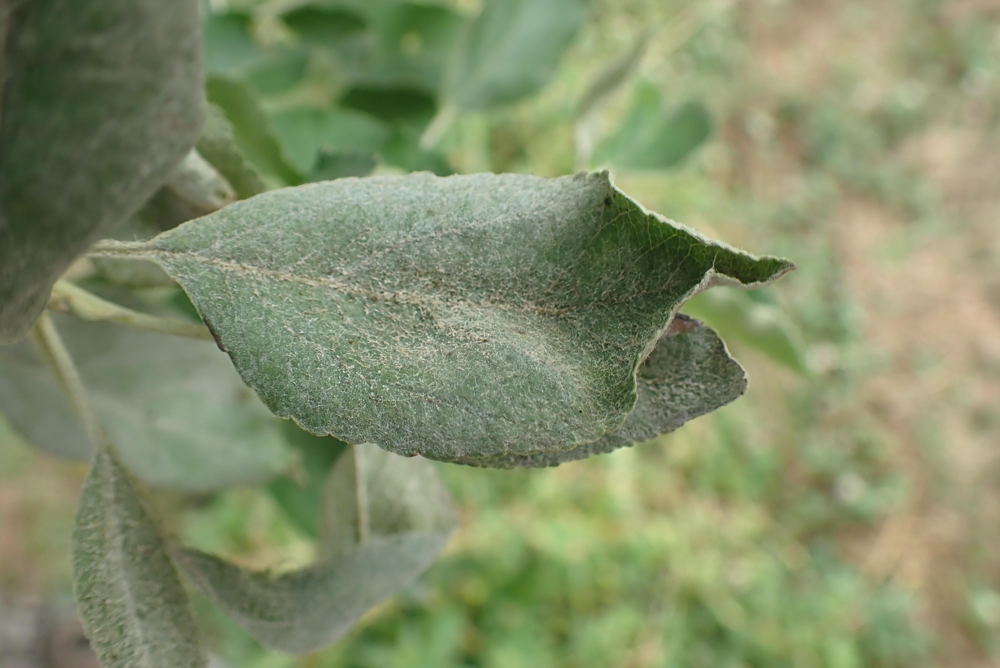

In [11]:
path = Path('../input/plant-pathology-2021-fgvc8')
from PIL import Image
from pathlib import Path

fname = Path(path/"train_images"/df.image[0])
im = Image.open(fname)
im

In [13]:
print(im.size)

(4000, 2672)


In [14]:
(path/"train_images").ls()

(#18632) [Path('../input/plant-pathology-2021-fgvc8/train_images/a8d54d0d96517ab3.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/ac6902fd1f0f3ce0.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/d4b7ea94e1c509e2.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/c780633f9d9d2970.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/a506c47f0f2d3d61.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/d4d8689596df6b80.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/edd8cfc45e503252.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/9ab326c1951acb7a.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/f728e036d729a0ad.jpg'),Path('../input/plant-pathology-2021-fgvc8/train_images/fce318c6518fd20e.jpg')...]

In [16]:
def get_x(r):  return path/"train_images"/r["image"]
def get_y(r):  return r["labels"]

## Build a small subset data (10% data) to test the model.

In [26]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.1, random_state=42) #Provides train/val indices to split data in train/val sets
for train_index, val_index in split.split(df, df["labels"]):
    strat_train_set = df.loc[train_index]
    strat_val_set = df.loc[val_index]

### use 10% data from each category, the percentage in each category remains the same compared to the complete data

In [35]:
strat_val_set.labels.value_counts(dropna=False)/strat_val_set.shape[0] *100

scab                               25.912017
healthy                            24.839056
frog_eye_leaf_spot                 17.060086
rust                                9.978541
complex                             8.583691
powdery_mildew                      6.330472
scab frog_eye_leaf_spot             3.701717
scab frog_eye_leaf_spot complex     1.072961
frog_eye_leaf_spot complex          0.858369
rust frog_eye_leaf_spot             0.643777
rust complex                        0.536481
powdery_mildew complex              0.482833
Name: labels, dtype: float64

In [37]:
df.labels.value_counts(dropna=False)/total * 100

scab                               25.901675
healthy                            24.817518
frog_eye_leaf_spot                 17.072778
rust                                9.982825
complex                             8.598111
powdery_mildew                      6.354659
scab frog_eye_leaf_spot             3.681838
scab frog_eye_leaf_spot complex     1.073422
frog_eye_leaf_spot complex          0.885573
rust frog_eye_leaf_spot             0.644053
rust complex                        0.520610
powdery_mildew complex              0.466939
Name: labels, dtype: float64

In [38]:
plants = DataBlock(blocks = (ImageBlock, CategoryBlock),
                 get_x= get_x, 
                 splitter=RandomSplitter(seed=42),
                 get_y= get_y,
                 item_tfms=Resize(460),
                 batch_tfms=aug_transforms(size=224, min_scale=0.5))

In [46]:
subdls = plants.dataloaders(strat_val_set,batch_size=16)
plants.summary(strat_val_set)

Setting-up type transforms pipelines
12428  d67cf43f202643e1.jpg             healthy
16107  f120922ccb33efa9.jpg                scab
4538   a4ba528c9d596f2c.jpg                rust
15197  eac515df55d60312.jpg                scab
14326  e48b937c4ebcde00.jpg  frog_eye_leaf_spot
...                     ...                 ...
10589  c9524b3cbf99ca0c.jpg                scab
8233   ba92d23e9120ce77.jpg                scab
6645   afae2ad16a21b1b1.jpg                scab
1139   885738a643da6b5b.jpg             healthy
2246   920938b66073ebf3.jpg                scab

[1864 rows x 2 columns]
Found 1864 items
2 datasets of sizes 1492,372
Setting up Pipeline: get_x -> PILBase.create
Setting up Pipeline: get_y -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}

Building one sample
  Pipeline: get_x -> PILBase.create
    starting from
      image     8b4f631bd3d89283.jpg
labels                 complex
Name: 1474, dtype: object
    applying get_x gives
      ../input/plant-pathology-202

In [ ]:
# dls = plants.dataloaders(df,batch_size=64)

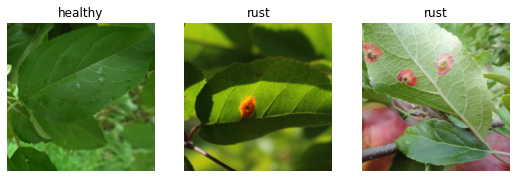

In [47]:
subdls.show_batch(nrows=1, ncols =3)

In [48]:
f1_score_multi = F1Score(average="weighted")

In [56]:
learn = cnn_learner(subdls, resnet50, metrics = [error_rate, f1_score_multi])

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [58]:
learn.fine_tune(10)

epoch,train_loss,valid_loss,error_rate,f1_score,time
0,1.859574,1.593058,0.362903,0.625361,04:59


epoch,train_loss,valid_loss,error_rate,f1_score,time
0,1.308024,1.025199,0.241935,0.743671,05:00
1,1.127865,1.004182,0.274194,0.714646,04:58
2,0.987212,0.938051,0.236559,0.744826,04:58
3,0.914049,0.816071,0.231183,0.753814,04:58
4,0.661367,0.875174,0.212366,0.763633,05:01
5,0.587530,0.674986,0.209677,0.786661,05:00
6,0.445592,0.641626,0.174731,0.816184,04:59
7,0.347412,0.667790,0.180108,0.805845,04:58
8,0.268169,0.711896,0.180108,0.807929,05:00
9,0.231052,0.671564,0.180108,0.804381,05:03


In [59]:
learn.export(fname= '/kaggle/working/plant_subset_resnet50.pkl')

In [53]:
learn.loss_func

FlattenedLoss of CrossEntropyLoss()

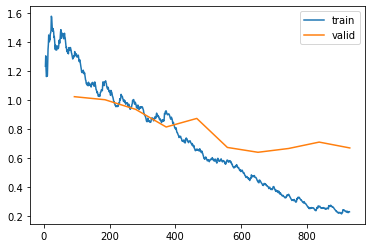

In [67]:
learn.recorder.plot_loss()

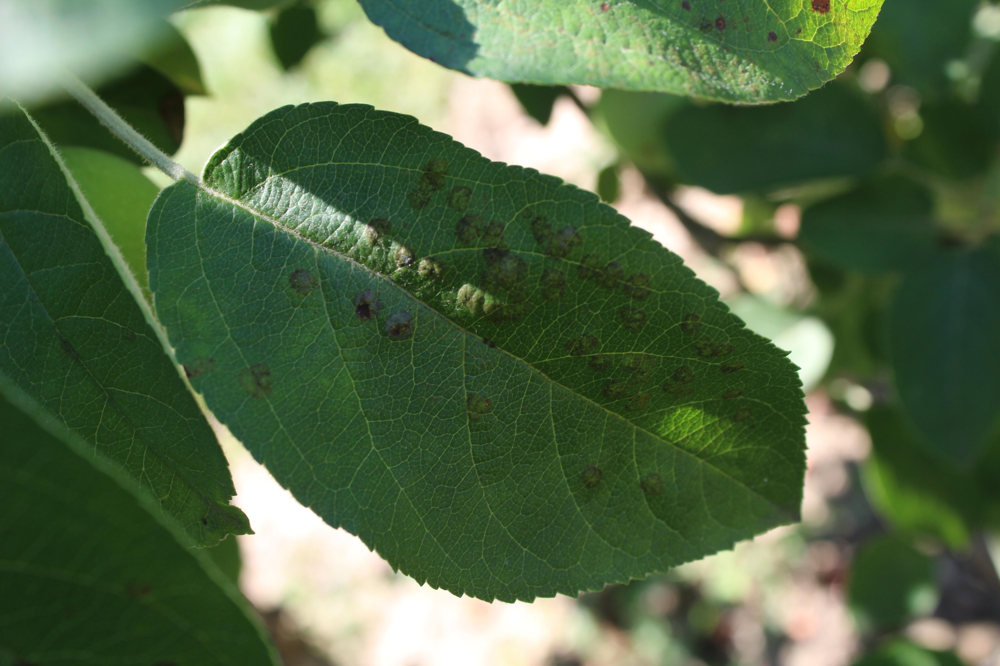

In [124]:
testfiles = Path("../input/plant-pathology-2021-fgvc8/test_images").ls()
test_img =PILImage.create(testfiles[2])
test_img

In [125]:
pred,*_= learn.predict(test_img)
pred

'rust'

In [112]:
tst = os.listdir("../input/plant-pathology-2021-fgvc8/test_images")
to_tst = pd.DataFrame({'image':tst})
to_tst

,image
0,ad8770db05586b59.jpg
1,c7b03e718489f3ca.jpg
2,85f8cb619c66b863.jpg


In [114]:
path.ls()

(#4) [Path('../input/plant-pathology-2021-fgvc8/sample_submission.csv'),Path('../input/plant-pathology-2021-fgvc8/train_images'),Path('../input/plant-pathology-2021-fgvc8/train.csv'),Path('../input/plant-pathology-2021-fgvc8/test_images')]

In [129]:
tst = get_image_files(path/'test_images')
test_dl = learn.dls.test_dl(tst,bs=16)
test_dl

In [156]:
preds = learn.get_preds(dl=test_dl) # get prediction
# to_np(preds)

In [167]:
labels = np.argmax(to_np(preds[0]),1)
labels

array([0, 1, 6])

In [168]:
subdls.vocab[labels]

(#3) ['complex','frog_eye_leaf_spot','rust']

In [171]:
to_tst['labels'] = subdls.vocab[labels]
to_tst.to_csv("/kaggle/working/plant_subset_resnet50_05122021.csv",index=False)